# Tubule Data Exploration

This notebook is meant to explore the Tubule dataset of breast histology images. Our goal is to train a deep learning classifier that can perform tubule segmentation. The details of the problem are located here: http://www.andrewjanowczyk.com/use-case-3-tubule-segmentation/

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

import cv2
import glob

Load in the images and corresponding annotations. 

In [39]:
imgs = []
annotations = []
for file in sorted(glob.glob("./Tubules_bmp/*.bmp")):
    img = cv2.imread(file)
    if 'anno' in file: 
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        annotations.append(img)
    else:
        imgs.append(img)

imgs = np.asarray(imgs)
annotations = np.asarray(annotations)

In [28]:
imgs = []
annotations = []
for file in sorted(glob.glob("./Tubules_bmp/*.bmp")):
    img = cv2.imread(file)
    if 'anno' in file: 
        # Do we want to convert this to its actual value - or 1
        img[img>0] = 1
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        annotations.append(img)
    else:
        imgs.append(img)

imgs = np.asarray(imgs)
annotations = np.asarray(annotations)

# Visualization

Example of a tissue image with its corresponding annotation indicating the locations of tubules in black. 

Different instances of tubules are labelled with different colors in this dataset.

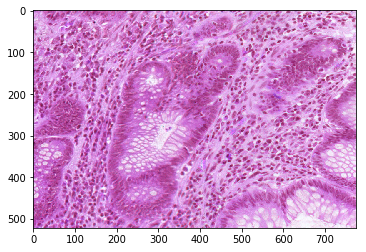

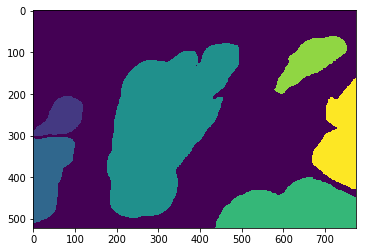

In [40]:
plt.figure()
plt.imshow(imgs[0])

plt.figure()
plt.imshow(annotations[0], cmap='viridis')

For some reason, the last 6 images of this dataset have different dimensions. 

In [12]:
# Turn the images of the same size into an array so that numpy actually stacks them. 
anno_ex = np.array(list(annotations[:-6]))
imgs_ex = np.array(list(imgs[:-6]))

In [43]:
# Shape of the first 79 images in the dataset
imgs_ex.shape

(79, 522, 775, 3)

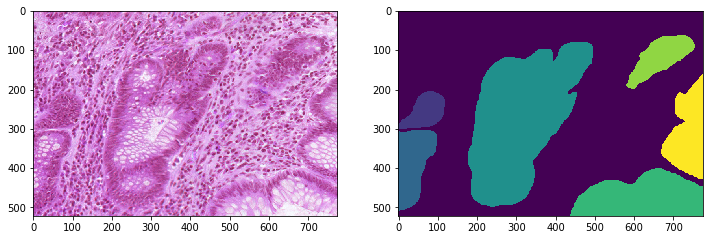

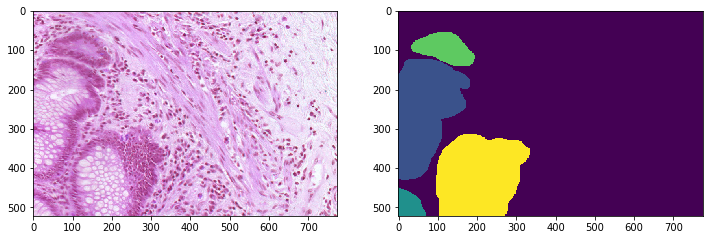

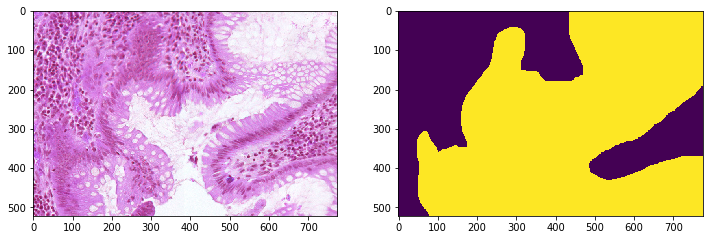

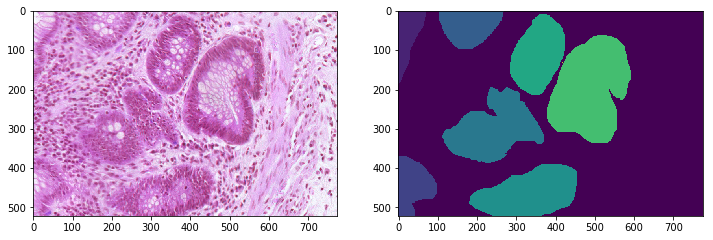

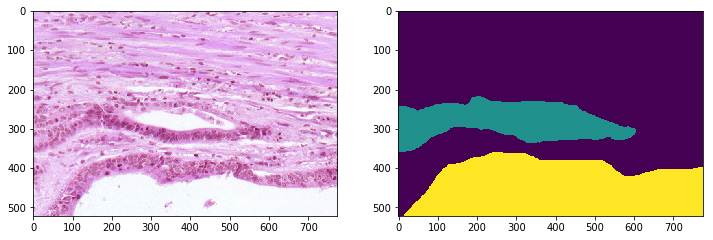

...

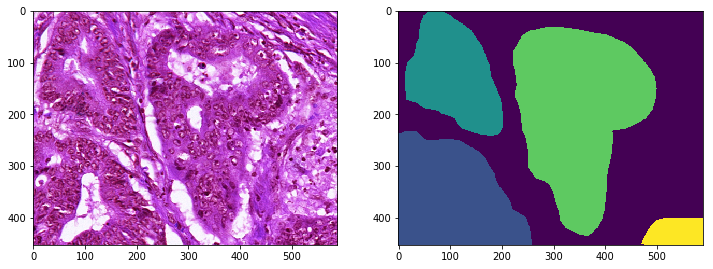

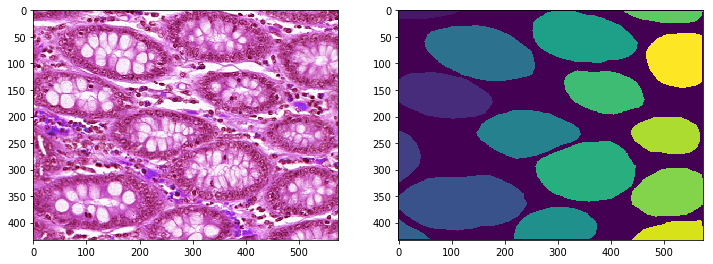

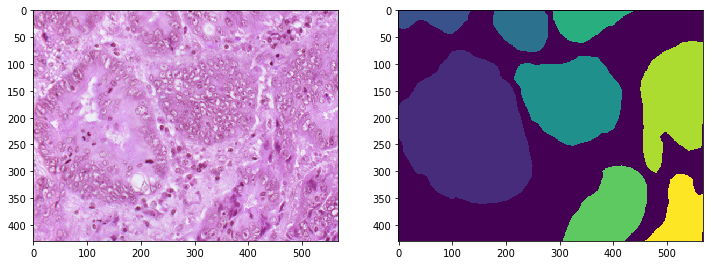

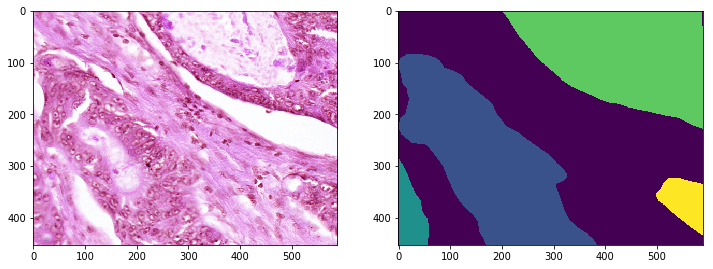

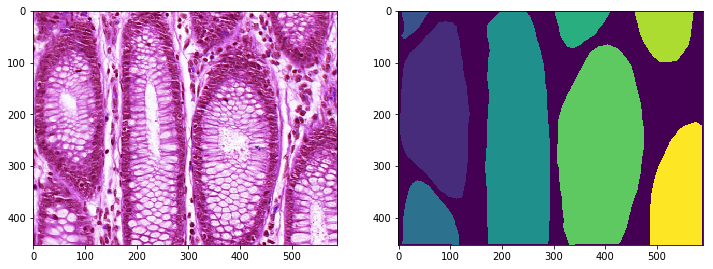

In [44]:
# All images, including the 6 with different dimensions. 
for img, anno in zip(imgs, annotations):
    plt.figure(figsize=(12, 8))
    ax1 = plt.subplot(1, 2, 1)
    ax2 = plt.subplot(1, 2, 2)
    ax1.imshow(img)
    ax2.imshow(anno)